<a href="https://colab.research.google.com/github/abhinavgairola/Lending_Club_Project/blob/master/Machine_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Machine learning and encoding of categorical data

In [1]:
#from google.colab import files

#uploaded = files.upload()

In [2]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
!pip install pycaret

In [4]:
#from pandas_profiling import ProfileReport
import matplotlib.pyplot as mp
from collections import Counter
import math
import scipy.stats as ss
from sklearn.preprocessing import LabelEncoder
import pandas as pd
import plotly as pf
import numpy as np
#.figure_factory as ff
import seaborn as sns
import plotly.express as px
from collections import Counter
import plotly.graph_objects as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
from plotly.offline import iplot, init_notebook_mode,plot
init_notebook_mode()
from urllib.request import urlopen
import json
from plotly.colors import n_colors
cm = sns.light_palette("green", as_cmap=True)
with open('/content/drive/My Drive/geoson-counties-fips.json') as json_:#urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(json_)
#from pycaret.classification import *
from pycaret.classification import *

In [5]:
def additive_smoothing(df, by, on, m):
    """ computes additive smoothing or Laplace smoothing
    @In, dataframe
    @In, by--feature to groupby
    @In, on-- target feature
    @In , m-- weight to be given to the global mean
    @Out, Laplace smoothed means
    """
    global_mean_target = df[on].mean()

    # Compute the number of values and the mean of each group
    agg = df.groupby(by)[on].agg(['count', 'mean'])
    counts = agg['count']
    means = agg['mean']

    # Compute the "smoothed" means
    smooth = (counts * means + m * global_mean_target) / (counts + m)
    return smooth#df[by].map(smooth)

In [6]:
def check_greater(by,on,df,count):
    """ The function checks the number of counts of a particular category in a categoricalfeature"""
    
    return Counter(list((df.groupby(by)[on].count().apply(lambda x: x if x>count else None).notnull().astype(int))))

In [7]:
df = pd.read_csv('/content/drive/My Drive/Lending_Club_clean.csv',chunksize=100000,low_memory=False)
dataframe = pd.concat(df)       

In [8]:
dataframe.head(3).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,loan_amnt,int_rate,annual_inc,dti,delinq_2yrs,fico_range_low,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,recoveries,last_pymnt_amnt,last_fico_range_high,collections_12_mths_ex_med,mths_since_last_major_derog,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,bc_open_to_buy,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_bc_tl,num_il_tl,num_tl_120dpd_2m,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,total_bal_ex_mort,revol_bal_joint,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_act_il,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,deferral_term,hardship_amount,hardship_last_payment_amount,settlement_amount,loan_status_binary,grade,emp_length,verification_status,issue_d,purpose,earliest_cr_line,initial_list_status,last_pymnt_d,next_pymnt_d,last_credit_pull_d,application_type,verification_status_joint,sec_app_earliest_cr_line,hardship_status,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date
0,3600.000000,13.990000,55000.000000,5.910000,0.000000,675.000000,1.000000,30.000000,72.312842,7.000000,0.000000,2765.000000,29.700000,13.000000,0.000000,4421.723917,821.720000,0.000000,0.000000,122.670000,564.000000,0.000000,30.000000,0.000000,0.000000,0.000000,722.000000,144904.000000,2.000000,2.000000,0.000000,1.000000,21.000000,4981.000000,36.000000,3.000000,3.000000,722.000000,34.000000,9300.000000,3.000000,1.000000,4.000000,4.000000,1506.000000,0.000000,0.000000,148.000000,128.000000,3.000000,3.000000,1.000000,4.000000,69.000000,4.000000,69.000000,2.000000,2.000000,5.000000,3.000000,0.000000,0.000000,3.000000,76.900000,0.000000,0.000000,7746.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,C,11 years,Not Verified,Dec-2015,debt_consolidation,Aug-2003,w,Jan-2019,nan,Mar-2019,Individual,nan,nan,nan,Cash,N,nan,nan,nan
1,24700.000000,11.990000,65000.000000,16.060000,1.000000,715.000000,4.000000,6.000000,72.312842,22.000000,0.000000,21470.000000,19.200000,38.000000,0.000000,25679.660000,979.660000,0.000000,0.000000,926.350000,699.000000,0.000000,44.164220,0.000000,0.000000,0.000000,0.000000,204396.000000,1.000000,1.000000,0.000000,1.000000,19.000000,18005.000000,73.000000,2.000000,3.000000,6472.000000,29.000000,111800.000000,0.000000,0.000000,6.000000,4.000000,57830.000000,0.000000,0.000000,113.000000,192.000000,2.000000,2.000000,4.000000,2.000000,39.303090,0.000000,6.000000,0.000000,5.000000,17.000000,6.000000,0.000000,0.000000,2.000000,97.400000,0.000000,0.000000,39475.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,C,11 years,Not Verified,Dec-2015,small_business,Dec-1999,w,Jun-2016,nan,Mar-2019,Individual,nan,nan,nan,Cash,N,nan,nan,nan
2,20000.000000,10.780000,63000.000000,10.780000,0.000000,695.000000,0.000000,34.540916,72.312842,6.000000,0.000000,7869.000000,56.200000,18.000000,0.000000,22705.924294,2705.920000,0.000000,0.000000,15813.300000,704.000000,0.000000,44.164220,71000.000000,13.850000,0.000000,0.000000,189699.000000,0.000000,1.000000,0.000000,4.000000,19.000000,10827.000000,73.000000,0.000000,2.000000,2081.000000,65.000000,14000.000000,2.000000,5.000000,1.000000,6.000000,2737.000000,0.000000,0.000000,125.000000,184.000000,14.000000,14.000000,5.000000,101.000000,39.303090,10.000000,35.782223,0.000000,2.00000

In [9]:
temp=dataframe.select_dtypes('object').fillna('')
columns_ob = dataframe.select_dtypes('object').columns
columns_ob

Index(['grade', 'emp_length', 'verification_status', 'issue_d', 'purpose',
       'earliest_cr_line', 'initial_list_status', 'last_pymnt_d',
       'next_pymnt_d', 'last_credit_pull_d', 'application_type',
       'verification_status_joint', 'sec_app_earliest_cr_line',
       'hardship_status', 'disbursement_method', 'debt_settlement_flag',
       'debt_settlement_flag_date', 'settlement_status', 'settlement_date'],
      dtype='object')

In [10]:
dataframe[list(columns_ob)] = temp.copy()

In [11]:
list(dataframe.select_dtypes('object').isna().mean().sort_values())

[0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0]

In [12]:
dataframe.head(3).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,loan_amnt,int_rate,annual_inc,dti,delinq_2yrs,fico_range_low,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,recoveries,last_pymnt_amnt,last_fico_range_high,collections_12_mths_ex_med,mths_since_last_major_derog,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,bc_open_to_buy,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_bc_tl,num_il_tl,num_tl_120dpd_2m,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,total_bal_ex_mort,revol_bal_joint,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_act_il,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,deferral_term,hardship_amount,hardship_last_payment_amount,settlement_amount,loan_status_binary,grade,emp_length,verification_status,issue_d,purpose,earliest_cr_line,initial_list_status,last_pymnt_d,next_pymnt_d,last_credit_pull_d,application_type,verification_status_joint,sec_app_earliest_cr_line,hardship_status,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date
0,3600.000000,13.990000,55000.000000,5.910000,0.000000,675.000000,1.000000,30.000000,72.312842,7.000000,0.000000,2765.000000,29.700000,13.000000,0.000000,4421.723917,821.720000,0.000000,0.000000,122.670000,564.000000,0.000000,30.000000,0.000000,0.000000,0.000000,722.000000,144904.000000,2.000000,2.000000,0.000000,1.000000,21.000000,4981.000000,36.000000,3.000000,3.000000,722.000000,34.000000,9300.000000,3.000000,1.000000,4.000000,4.000000,1506.000000,0.000000,0.000000,148.000000,128.000000,3.000000,3.000000,1.000000,4.000000,69.000000,4.000000,69.000000,2.000000,2.000000,5.000000,3.000000,0.000000,0.000000,3.000000,76.900000,0.000000,0.000000,7746.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,C,11 years,Not Verified,Dec-2015,debt_consolidation,Aug-2003,w,Jan-2019,,Mar-2019,Individual,,,,Cash,N,,,
1,24700.000000,11.990000,65000.000000,16.060000,1.000000,715.000000,4.000000,6.000000,72.312842,22.000000,0.000000,21470.000000,19.200000,38.000000,0.000000,25679.660000,979.660000,0.000000,0.000000,926.350000,699.000000,0.000000,44.164220,0.000000,0.000000,0.000000,0.000000,204396.000000,1.000000,1.000000,0.000000,1.000000,19.000000,18005.000000,73.000000,2.000000,3.000000,6472.000000,29.000000,111800.000000,0.000000,0.000000,6.000000,4.000000,57830.000000,0.000000,0.000000,113.000000,192.000000,2.000000,2.000000,4.000000,2.000000,39.303090,0.000000,6.000000,0.000000,5.000000,17.000000,6.000000,0.000000,0.000000,2.000000,97.400000,0.000000,0.000000,39475.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,C,11 years,Not Verified,Dec-2015,small_business,Dec-1999,w,Jun-2016,,Mar-2019,Individual,,,,Cash,N,,,
2,20000.000000,10.780000,63000.000000,10.780000,0.000000,695.000000,0.000000,34.540916,72.312842,6.000000,0.000000,7869.000000,56.200000,18.000000,0.000000,22705.924294,2705.920000,0.000000,0.000000,15813.300000,704.000000,0.000000,44.164220,71000.000000,13.850000,0.000000,0.000000,189699.000000,0.000000,1.000000,0.000000,4.000000,19.000000,10827.000000,73.000000,0.000000,2.000000,2081.000000,65.000000,14000.000000,2.000000,5.000000,1.000000,6.000000,2737.000000,0.000000,0.000000,125.000000,184.000000,14.000000,14.000000,5.000000,101.000000,39.303090,10.000000,35.782223,0.000000,2.000000,4.000000,6.000000,0.000000,0.000000,0.00

### Some of the object features are of very high cardinality. one hot encoding will make a feature explosion. The following link and library mentions about some ways to deal with features with very high cardinality. http://contrib.scikit-learn.org/category_encoders/index.html. I can use hashing but the hashing algorithm may put different categories in the same group--might affect the target negatively. Other way around is the target encoding which is explained quite well in the following link--https://maxhalford.github.io/blog/target-encoding/I could have used the mean encoding. However, I decide to follow the Laplace smoothing of the local mean. It is because if there is a very low occurence of a certain instance of a feature then its local mean cannot be trusted. Then a more heavy emphasis should be given on the global mean.


In [13]:
obj_data = dataframe.select_dtypes('object')
obj_data.head(3).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,grade,emp_length,verification_status,issue_d,purpose,earliest_cr_line,initial_list_status,last_pymnt_d,next_pymnt_d,last_credit_pull_d,application_type,verification_status_joint,sec_app_earliest_cr_line,hardship_status,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date
0,C,11 years,Not Verified,Dec-2015,debt_consolidation,Aug-2003,w,Jan-2019,,Mar-2019,Individual,,,,Cash,N,,,
1,C,11 years,Not Verified,Dec-2015,small_business,Dec-1999,w,Jun-2016,,Mar-2019,Individual,,,,Cash,N,,,
2,B,11 years,Not Verified,Dec-2015,home_improvement,Aug-2000,w,Jun-2017,,Mar-2019,Joint App,Not Verified,,,Cash,N,,,


In [14]:
df_empty = pd.DataFrame({'less_than_'+str(200)+'_counts_categories': [],'greater_than_'+str(200)+'_counts_categories':[]})
unique=[]
for key in list(obj_data.columns):
    unique.append(obj_data[key].nunique())
    
    Count = dict(check_greater(key,'loan_status_binary',dataframe,200))
    #print(pd.DataFrame(Count,index=[0]))
    
    df_empty = pd.concat([df_empty,pd.DataFrame(Count,index=[key]).rename(columns={1:'greater_than_'+str(200)+'_counts_categories',0:'less_than_'+str(200)+'_counts_categories'})])
#pd.DataFrame(Count,index=[key]).rename(columns={1:'greater_than_'+str(200)+'_counts',0:'less_than_'+str(200)+'_counts'})
df_empty = df_empty.fillna(0)

df_empty['unique_category'] = unique
df_unique =df_empty.copy()

In [15]:
df_unique['ratio'] = df_unique['greater_than_200_counts_categories'].values/df_unique['less_than_200_counts_categories'].values

In [16]:
df_unique = df_unique.replace(np.inf,np.nan)
df_unique.style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,less_than_200_counts_categories,greater_than_200_counts_categories,unique_category,ratio
grade,1.000000,7.000000,8,7.000000
emp_length,0.000000,12.000000,12,nan
verification_status,1.000000,3.000000,4,3.000000
issue_d,14.000000,126.000000,140,9.000000
purpose,1.000000,14.000000,15,14.000000
earliest_cr_line,235.000000,520.000000,755,2.212766
initial_list_status,1.000000,2.000000,3,2.000000
last_pymnt_d,32.000000,105.000000,137,3.281250
next_pymnt_d,104.000000,3.000000,107,0.028846
last_credit_pull_d,56.000000,86.000000,142,1.535714


In [17]:
### It means there are 14 columns with less than 200 counts and all the other columns have higher count. We can work with the local mean too.

In [18]:
vals = df_unique.ratio.values
for i, idx in enumerate(list(df_unique.index)):
    
    #print(idx,vals[i])
    
    if vals[i] > 2 or vals[i] == np.nan:
        ### local means can be trusted and the weight is set to 2:
        smooth = additive_smoothing(dataframe,idx,'loan_status_binary',2)
        obj_data[idx+'_encoded'] = obj_data[idx]
        obj_data[idx+'_encoded'] = obj_data[idx+'_encoded'].map(smooth)
    elif vals[i]<2:
        ### perform smoothing towards the global mean
        print("Performing smoothing towards global mean",vals[i])
        smooth = additive_smoothing(dataframe,idx,'loan_status_binary',100)
        obj_data[idx+'_encoded'] = obj_data[idx]
        obj_data[idx+'_encoded'] = obj_data[idx+'_encoded'].map(smooth)
        
    #obj_data[idx+'_encoded'] = obj_data[idx]
    #obj_data[idx+'_encoded'] = obj_data[idx+'_encoded'].map(smooth)
            
#obj_data

Performing smoothing towards global mean 0.028846153846153848
Performing smoothing towards global mean 1.5357142857142858
Performing smoothing towards global mean 0.43722943722943725
Performing smoothing towards global mean 0.5
Performing smoothing towards global mean 0.4918032786885246


In [19]:
obj_data.select_dtypes('float64').isnull().mean()

grade_encoded                        0.0
verification_status_encoded          0.0
issue_d_encoded                      0.0
purpose_encoded                      0.0
earliest_cr_line_encoded             0.0
last_pymnt_d_encoded                 0.0
next_pymnt_d_encoded                 0.0
last_credit_pull_d_encoded           0.0
sec_app_earliest_cr_line_encoded     0.0
debt_settlement_flag_date_encoded    0.0
settlement_date_encoded              0.0
dtype: float64

In [20]:
dataframe['loan_status_binary']=dataframe['loan_status_binary'].astype(int)

In [21]:
dataframe['loan_status_binary']

0          0
1          0
2          0
3          0
4          0
          ..
2260696    0
2260697    1
2260698    0
2260699    0
2260700    0
Name: loan_status_binary, Length: 2260701, dtype: int64

In [22]:
Ml_data = pd.concat([dataframe.select_dtypes('float64'),dataframe.select_dtypes(int),obj_data.select_dtypes('float64')],axis=1)

In [23]:
Ml_data.head(5).style.set_properties(**{'background-color': 'black',
                           'color': 'lawngreen',
                           'border-color': 'white'})

,loan_amnt,int_rate,annual_inc,dti,delinq_2yrs,fico_range_low,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,recoveries,last_pymnt_amnt,last_fico_range_high,collections_12_mths_ex_med,mths_since_last_major_derog,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,bc_open_to_buy,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_bc_tl,num_il_tl,num_tl_120dpd_2m,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,pub_rec_bankruptcies,tax_liens,total_bal_ex_mort,revol_bal_joint,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_act_il,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,deferral_term,hardship_amount,hardship_last_payment_amount,settlement_amount,loan_status_binary,grade_encoded,verification_status_encoded,issue_d_encoded,purpose_encoded,earliest_cr_line_encoded,last_pymnt_d_encoded,next_pymnt_d_encoded,last_credit_pull_d_encoded,sec_app_earliest_cr_line_encoded,debt_settlement_flag_date_encoded,settlement_date_encoded
0,3600.000000,13.990000,55000.000000,5.910000,0.000000,675.000000,1.000000,30.000000,72.312842,7.000000,0.000000,2765.000000,29.700000,13.000000,0.000000,4421.723917,821.720000,0.000000,0.000000,122.670000,564.000000,0.000000,30.000000,0.000000,0.000000,0.000000,722.000000,144904.000000,2.000000,2.000000,0.000000,1.000000,21.000000,4981.000000,36.000000,3.000000,3.000000,722.000000,34.000000,9300.000000,3.000000,1.000000,4.000000,4.000000,1506.000000,0.000000,0.000000,148.000000,128.000000,3.000000,3.000000,1.000000,4.000000,69.000000,4.000000,69.000000,2.000000,2.000000,5.000000,3.000000,0.000000,0.000000,3.000000,76.900000,0.000000,0.000000,7746.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.131757,0.079934,0.183476,0.129131,0.118209,0.032642,0.199615,0.047932,0.122612,0.105679,0.105679
1,24700.000000,11.990000,65000.000000,16.060000,1.000000,715.000000,4.000000,6.000000,72.312842,22.000000,0.000000,21470.000000,19.200000,38.000000,0.000000,25679.660000,979.660000,0.000000,0.000000,926.350000,699.000000,0.000000,44.164220,0.000000,0.000000,0.000000,0.000000,204396.000000,1.000000,1.000000,0.000000,1.000000,19.000000,18005.000000,73.000000,2.000000,3.000000,6472.000000,29.000000,111800.000000,0.000000,0.000000,6.000000,4.000000,57830.000000,0.000000,0.000000,113.000000,192.000000,2.000000,2.000000,4.000000,2.000000,39.303090,0.000000,6.000000,0.000000,5.000000,17.000000,6.000000,0.000000,0.000000,2.000000,97.400000,0.000000,0.000000,39475.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0,0.131757,0.079934,0.183476,0.185502,0.127533,0.271400,0.199615,0.047932,0.122612,0.105679,0.105679
2,20000.000000,10.780000,63000.000000,10.780000,0.000000,695.000000,0.000000,34.540916,72.312842,6.000000,0.000000,7869.000000,56.200000,18.000000,0.000000,22705.924294,2705.920000,0.000000,0.000000,15813.300000,704.000000,0.000000,44.164220,71000.000000,13.850000,0.000000,0.000000,189699.000000,0.000000,1.000000,0.000000,4.000000,19.000000,10827.000000,73.000000,0.000000,2.000000,2081.000000,65.000000,14000.000000,2.000000,5.000000,1.000000,6.000000,2737.000000,0.000000,0.000000,125.000000,184.000000,14.000000,14.000000,5.000000,101.000000,39.303090,10.000000,35.782223,0.000000,2.000000,4.000000,6.000000,0.000000,0.000000,0.000000,100.000000,0.000000,0.000000,18696.000000,0.000000,0.000000,0.000000,0.000000,0.

### I will drop the next_pymnt_d_encoded feature as it may be too much indicative of the target variable.

### I will remove the recoveries feature too as it is the "post charge off recovery"---this is only available after a charge off has occured and shouldn't be included in the model development.

In [24]:
pycaret_session = setup(data =Ml_data, fold=3, target = 'loan_status_binary',n_jobs=-1,use_gpu=True,normalize=True,ignore_features=['debt_settlement_flag_date_encoded','settlement_amount','last_pymnt_d_encoded','settlement_date_encoded','next_pymnt_d_encoded','recoveries','out_prncp','last_pymnt_amnt'])

,Description,Value
0,session_id,8423
1,Target,loan_status_binary
2,Target Type,Binary
3,Label Encoded,"0: 0, 1: 1"
4,Original Data,"(2260701, 90)"
5,Missing Values,False
6,Numeric Features,80
7,Categorical Features,1
8,Ordinal Features,False
9,High Cardinality Features,False


In [25]:
sorted(list(Ml_data.columns))#.str.contains(regex='Settlment')

['acc_now_delinq',
 'acc_open_past_24mths',
 'all_util',
 'annual_inc',
 'annual_inc_joint',
 'bc_open_to_buy',
 'chargeoff_within_12_mths',
 'collections_12_mths_ex_med',
 'debt_settlement_flag_date_encoded',
 'deferral_term',
 'delinq_2yrs',
 'delinq_amnt',
 'dti',
 'dti_joint',
 'earliest_cr_line_encoded',
 'fico_range_low',
 'grade_encoded',
 'hardship_amount',
 'hardship_last_payment_amount',
 'il_util',
 'inq_fi',
 'inq_last_12m',
 'inq_last_6mths',
 'int_rate',
 'issue_d_encoded',
 'last_credit_pull_d_encoded',
 'last_fico_range_high',
 'last_pymnt_amnt',
 'last_pymnt_d_encoded',
 'loan_amnt',
 'loan_status_binary',
 'max_bal_bc',
 'mo_sin_old_il_acct',
 'mo_sin_old_rev_tl_op',
 'mo_sin_rcnt_rev_tl_op',
 'mo_sin_rcnt_tl',
 'mort_acc',
 'mths_since_last_delinq',
 'mths_since_last_major_derog',
 'mths_since_last_record',
 'mths_since_rcnt_il',
 'mths_since_recent_bc',
 'mths_since_recent_bc_dlq',
 'mths_since_recent_inq',
 'mths_since_recent_revol_delinq',
 'next_pymnt_d_encoded',

### I will start with logistic regression to perform the classification of 'charged off status'.

In [26]:
logistic = create_model('lr')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9597,0.9802,0.7842,0.8631,0.8218,0.7991,0.8003
1,0.9592,0.9802,0.7822,0.8609,0.8197,0.7967,0.7979
2,0.9593,0.9800,0.7826,0.8610,0.8199,0.7970,0.7982
Mean,0.9594,0.9801,0.7830,0.8616,0.8204,0.7976,0.7988
SD,0.0002,0.0001,0.0009,0.0010,0.0009,0.0011,0.0011


In [27]:
tuned_lr = tune_model(logistic,n_iter=3, optimize='auc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9346,0.9807,0.9381,0.6568,0.7726,0.7358,0.7517
1,0.9342,0.9807,0.9368,0.6554,0.7712,0.7342,0.7502
2,0.9343,0.9805,0.9367,0.6559,0.7715,0.7345,0.7504
Mean,0.9343,0.9806,0.9372,0.6560,0.7718,0.7348,0.7508
SD,0.0002,0.0001,0.0006,0.0006,0.0006,0.0007,0.0007


The machine learning model has been built and tuned. various metrics have been spitted out by pycaret computed over a confusion matrix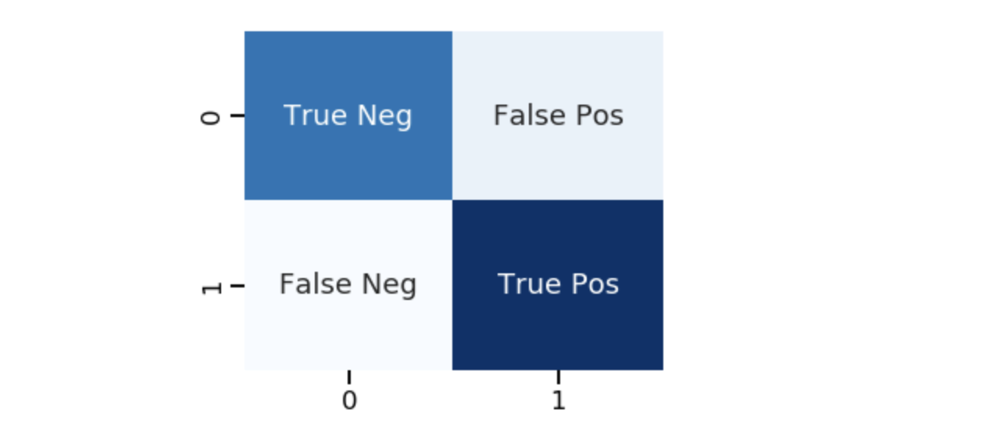. For example Accuracy = $\frac{\text{Total number of correct predictions}}{\text{Total predictions made}}$, Precision = $\frac{\text{True positive}}{\text{True positive + False positive}}$, Recall = $\frac{\text{True positive}}{\text{True positive + False negative}}$, F1 score= $\frac{\text{2* Precision*Recall}}{\text{Precision+Recall}}$, MCC = $\frac{TP*TN-FP*FN}{\sqrt{(TP+FP)(TP+FN)(TN+FP)(TN+FN}}$. For a binary classification problem this seems to be a great performance as even the MCC is quite high for this model. 






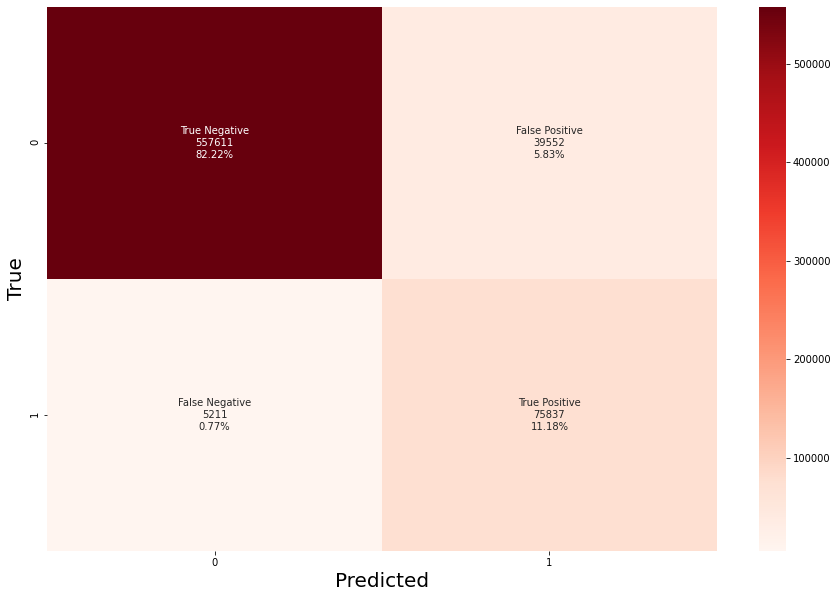

In [28]:
from sklearn.metrics import confusion_matrix
get_config(variable="y_test")
X_trianing = get_config(variable="X_train")
Y_training = get_config(variable="y_train")
X_test = get_config(variable="X_test")
Y_test = get_config(variable="y_test")
labels = ['True Negative','False Positive','False Negative','True Positive']
cf_matrix = confusion_matrix(Y_test.values,tuned_lr.predict(X_test))
group_counts = ['{0:0.0f}'.format(value) for value in
                cf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                    cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(labels,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
mp.figure(figsize=(15,10))
sns.heatmap(cf_matrix,annot=labels,fmt='',cmap='Reds',cbar=True)
mp.xlabel(r'Predicted',fontsize=20)
mp.ylabel(r'True',fontsize=20)
mp.show()


### We can extract the training and testing set used by pycaret_test_2 tuple to feed on to the confusion_matrix function of sklearn to do the computation. We can also compute the precision and recall curve and the feature importance curves using our favorite plotting libraries. I will plot the feature importance and compute the Shap values. 

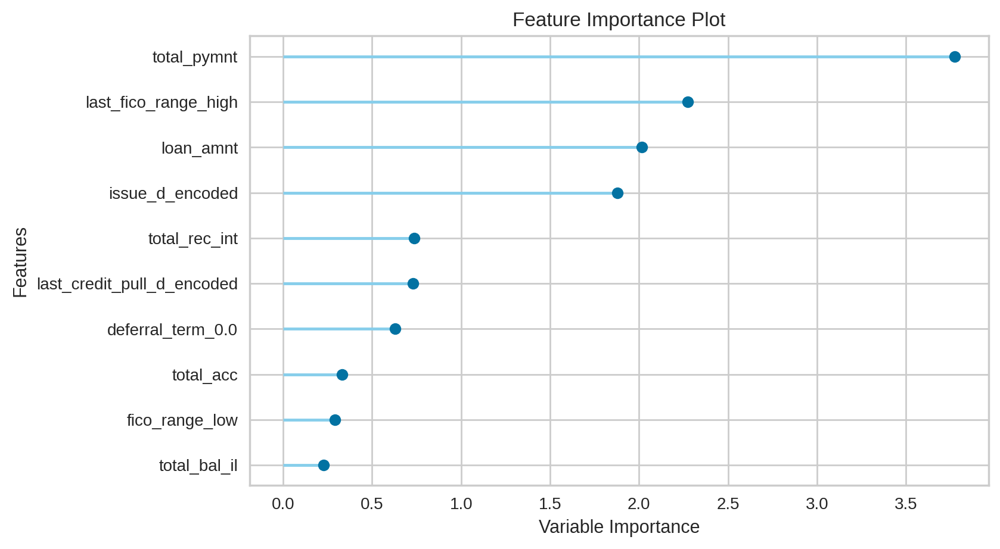

In [29]:
#feature_importance = abs(tuned_lr.coef_[0])
#feature_importance
#feature_importance = 100.0 * (feature_importance / feature_importance.max())
#sorted_idx = np.argsort(feature_importance)
#pos = np.arange(sorted_idx.shape[0]) + .5

#featfig = mp.figure(figsize=(35,20))
#featax = featfig.add_subplot(1, 1, 1)
#featax.barh(pos, feature_importance[sorted_idx], align='center')
#featax.set_yticks(pos)
#featax.set_yticklabels(np.array(X_test.columns)[sorted_idx])
#featax.set_xlabel('Relative Feature Importance')
#mp.tight_layout()   
#mp.show()
plot_model(tuned_lr, plot = 'feature',scale=2)



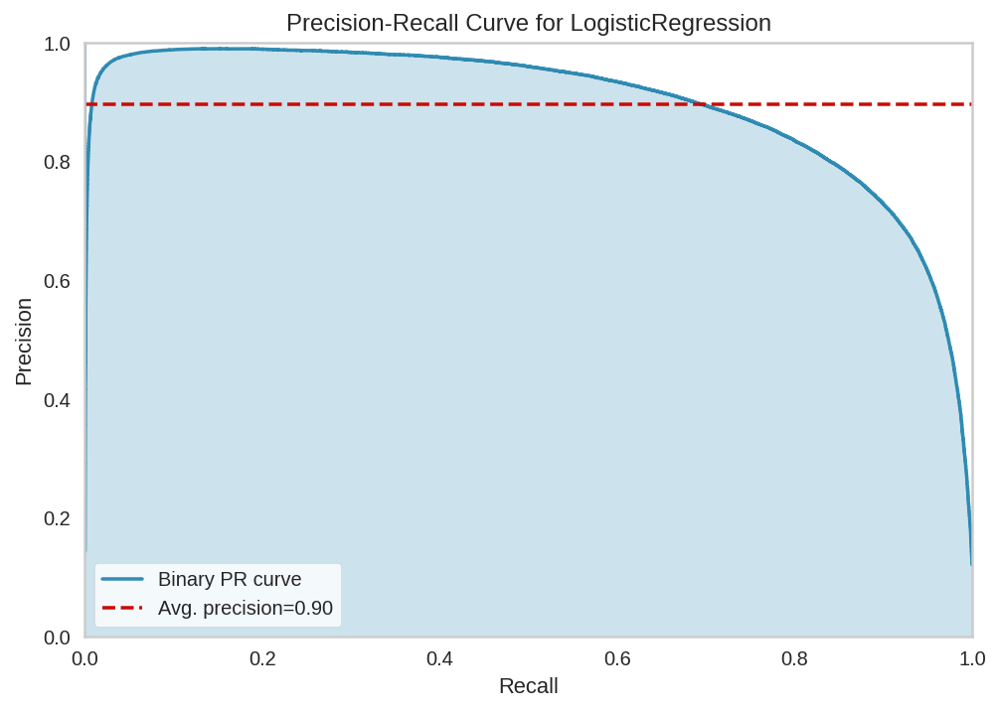

In [30]:


plot_model(tuned_lr, plot = 'pr',scale=2)



### Clearly both the precision and recall are close to 1 this means that the model has very low count of False positive and False negatives.

In [31]:
decision_tree = create_model('dt')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9756,0.9431,0.9005,0.8946,0.8975,0.8837,0.8837
1,0.9755,0.9423,0.8989,0.8948,0.8969,0.8830,0.8830
2,0.9755,0.9430,0.9003,0.8940,0.8972,0.8833,0.8833
Mean,0.9756,0.9428,0.8999,0.8945,0.8972,0.8833,0.8833
SD,0.0001,0.0003,0.0007,0.0004,0.0003,0.0003,0.0003


In [32]:
#tuned_dt = ensemble_model(decision_tree, method = 'Bagging')
tuned_dt = tune_model(decision_tree,n_iter=6, optimize='auc')
#tuned_model = ensemble_model(tuned_model,method='Bagging')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8815,0.8618,0.0000,0.0000,0.0000,0.0000,0.0000
1,0.8913,0.8677,0.1722,0.6585,0.2730,0.2354,0.2988
2,0.8841,0.8603,0.3413,0.5163,0.4109,0.3496,0.3588
Mean,0.8856,0.8632,0.1712,0.3916,0.2280,0.1950,0.2192
SD,0.0042,0.0032,0.1393,0.2829,0.1708,0.1456,0.1569


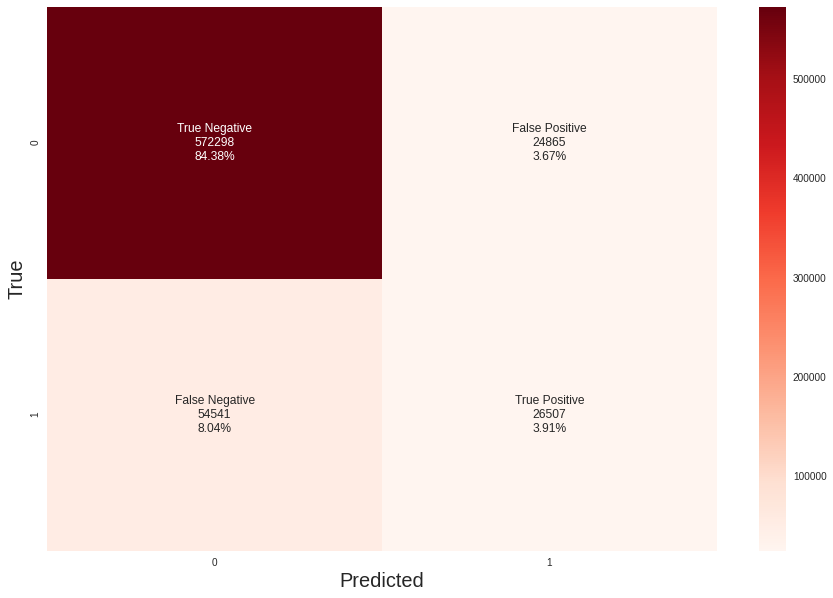

In [33]:
labels = ['True Negative','False Positive','False Negative','True Positive']
cf_matrix = confusion_matrix(Y_test.values,tuned_dt.predict(X_test))
group_counts = ['{0:0.0f}'.format(value) for value in
                cf_matrix.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in
                    cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f'{v1}\n{v2}\n{v3}' for v1, v2, v3 in
          zip(labels,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
mp.figure(figsize=(15,10))
sns.heatmap(cf_matrix,annot=labels,fmt='',cmap='Reds',cbar=True)
mp.xlabel(r'Predicted',fontsize=20)
mp.ylabel(r'True',fontsize=20)
mp.show()


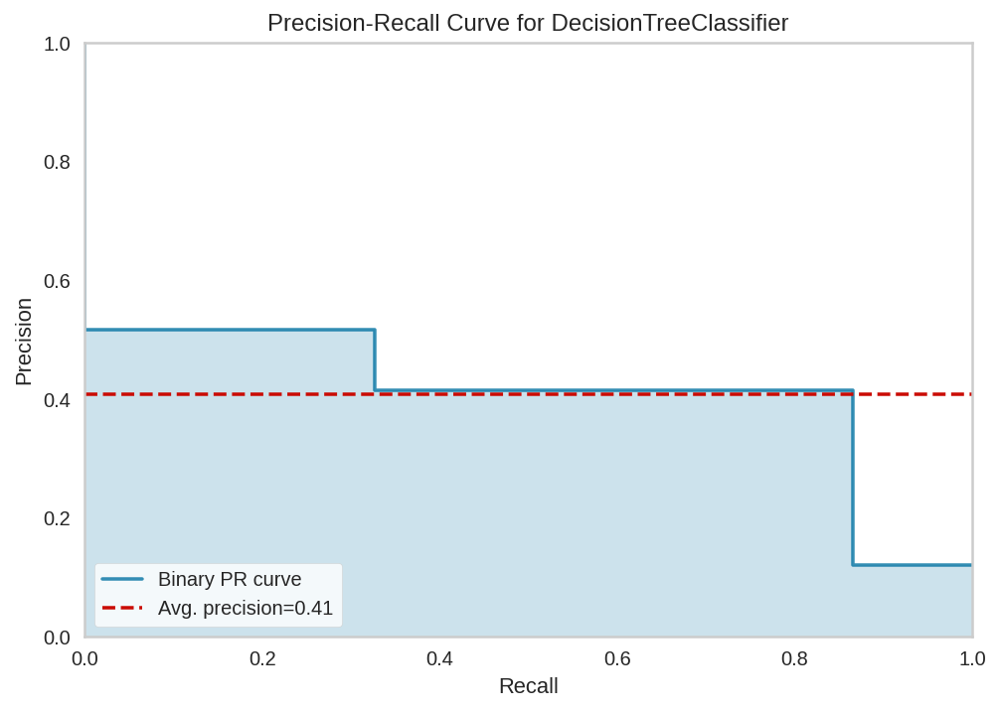

In [34]:
plot_model(tuned_dt, plot = 'pr',scale=2)

In [35]:
!pip install shap

     |████████████████████████████████| 327kB 13.9MB/s 
  Created wheel for shap: filename=shap-0.37.0-cp36-cp36m-linux_x86_64.whl size=463908 sha256=c363f1ee569ebdef0229c4cc9d3518728341edc6d9de6105ea296a88965eece7
  Stored in directory: /root/.cache/pip/wheels/df/ad/b0/aa7815ec68850d66551ef618095eccb962c8f6022f1d3dd989
Successfully built shap


In [36]:
import shap

In [37]:
explainer = shap.TreeExplainer(tuned_dt,approximate=True)
shap_values = explainer.shap_values(X_test[0:5000])

# visualize the first prediction's explanation (use matplotlib=True to avoid Javascript)
#shap.force_plot(explainer.expected_value[1], shap_values[1], X_trianing[0:5000])

In [38]:
shap.initjs()
shap.force_plot(explainer.expected_value[1], shap_values[1], X_test[0:5000])

In [39]:
X_test.iloc[0,:]

loan_amnt                          -0.331790
int_rate                           -0.082806
annual_inc                          0.189986
dti                                 0.609528
delinq_2yrs                        -0.353647
                                      ...   
purpose_encoded                    -1.384322
earliest_cr_line_encoded            0.148365
last_credit_pull_d_encoded         -0.501322
sec_app_earliest_cr_line_encoded    0.217923
deferral_term_0.0                   1.000000
Name: 148156, Length: 81, dtype: float32

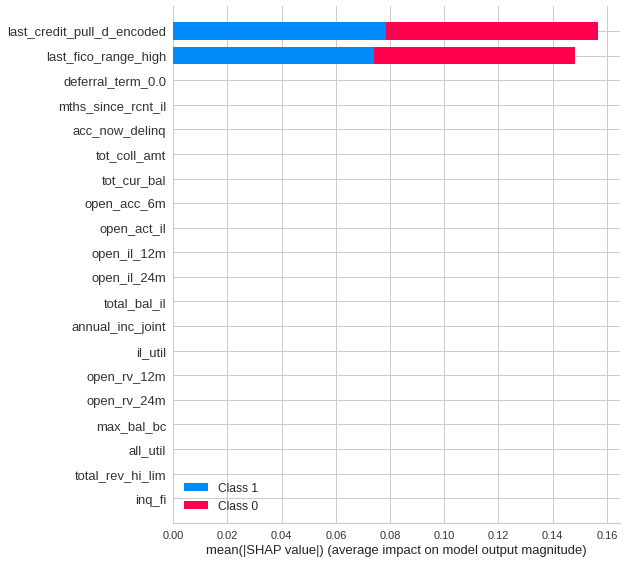

In [40]:
interpret_model(tuned_dt)